In [53]:
import numpy as np
from datasets import load_dataset
import sys
import torch

from PIL import Image
import torch.nn as nn
from src.datasets.imagenet1k import make_imagenet1k as asdf
from src import helper
from src.models import vision_transformer
from datasets import Dataset, DatasetDict
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from src.transforms import make_transforms
from torchvision import datasets, transforms
from torch.utils.data import random_split
from my_code.NN import EncodeLNClassify

%load_ext autoreload
%autoreload 2

# Mean: tensor([1127.8231, 4012.8442, 7170.1636])
# Std: tensor([3.8292e+15, 4.8477e+16, 1.5477e+17])

MEAN = torch.Tensor([1127.8231, 4012.8442, 7170.1636])
STD  = torch.Tensor([3.8292e+15, 4.8477e+16, 1.5477e+17])

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [54]:
CHECKPOINT_FILE = './checkpoint/IN1K-vit.h.14-300e.pth.tar'
checkpoint = torch.load(CHECKPOINT_FILE, map_location=torch.device('cpu'))
target_encoder_weights = checkpoint['target_encoder']
del checkpoint
import gc
gc.collect()

import copy
d = torch.device('cuda:0')
# d = torch.device('cpu')
torch.cuda.set_device(d)

encoder, predictor = helper.init_model(
    device = d,
    patch_size=14,
    crop_size=224,
    pred_depth=12,
    pred_emb_dim=384,
    model_name='vit_huge')

target_encoder = copy.deepcopy(encoder)

target_encoder_weights = {k.replace('module.', ''): v for k, v in target_encoder_weights.items()}

target_encoder.eval()

# Just want to train the linear classifier part.
for p in target_encoder.parameters():
    p.requires_grad = False

msg = target_encoder.load_state_dict(target_encoder_weights)
gc.collect()

/tmp/ipykernel_702/982290615.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(CHECKPOINT_FILE, map_location=torch.device('cpu'))


INFO:root:VisionTransformer(
  (patch_embed): PatchEmbed(
    (proj): Conv2d(3, 1280, kernel_size=(14, 14), stride=(14, 14))
  )
  (blocks): ModuleList(
    (0-31): 32 x Block(
      (norm1): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
      (attn): Attention(
        (qkv): Linear(in_features=1280, out_features=3840, bias=True)
        (attn_drop): Dropout(p=0.0, inplace=False)
        (proj): Linear(in_features=1280, out_features=1280, bias=True)
        (proj_drop): Dropout(p=0.0, inplace=False)
      )
      (drop_path): Identity()
      (norm2): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
      (mlp): MLP(
        (fc1): Linear(in_features=1280, out_features=5120, bias=True)
        (act): GELU(approximate='none')
        (fc2): Linear(in_features=5120, out_features=1280, bias=True)
        (drop): Dropout(p=0.0, inplace=False)
      )
    )
  )
  (norm): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
)


0

In [55]:
model = EncodeLNClassify(target_encoder)
model.load_state_dict(torch.load("./checkpoint/Few_shot_IJEPA_CIFAR10.pth", map_location='cpu'))
model.to('cpu')
torch.cuda.empty_cache()
gc.collect()


/tmp/ipykernel_702/1439801864.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("./checkpoint/Few_shot_IJEPA_CIFAR10.pth", map_location='c

9

In [56]:
device = next(model.parameters()).device
print(f"The model is on: {device}")

The model is on: cpu


In [57]:
def get_model_size(model):
    total_size = 0
    for param in model.parameters():
        total_size += param.nelement() * param.element_size()
    for buffer in model.buffers():
        total_size += buffer.nelement() * buffer.element_size()
    return total_size

# Example usage:

model_size_bytes = get_model_size(model)
model_size_mb = model_size_bytes / (1024 ** 2)
print(f"Model size: {model_size_bytes} bytes ({model_size_mb:.2f} MB)")

Model size: 2533704232 bytes (2416.33 MB)


In [58]:
import os
import psutil
print(f"Logical CPUs: {os.cpu_count()}")
print(f"Physical CPUs: {psutil.cpu_count(logical=False)}")


Logical CPUs: 20
Physical CPUs: 10


In [59]:
torch.set_num_threads(10)

In [60]:
from scipy.ndimage import gaussian_filter1d

def blur_image(X, sigma=1):
    X_np = X.cpu().clone().numpy()
    X_np = gaussian_filter1d(X_np, sigma, axis=2)
    X_np = gaussian_filter1d(X_np, sigma, axis=3)
    X.copy_(torch.Tensor(X_np).type_as(X))
    return X

def jitter(X, ox, oy):
    """
    Helper function to randomly jitter an image.

    Inputs
    - X: PyTorch Tensor of shape (N, C, H, W)
    - ox, oy: Integers giving number of pixels to jitter along W and H axes

    Returns: A new PyTorch Tensor of shape (N, C, H, W)
    """
    if ox != 0:
        left = X[:, :, :, :-ox]
        right = X[:, :, :, -ox:]
        X = torch.cat([right, left], dim=3)
    if oy != 0:
        top = X[:, :, :-oy]
        bottom = X[:, :, -oy:]
        X = torch.cat([bottom, top], dim=2)
    return X

In [61]:
import torch
print(f"Memory allocated: {torch.cuda.memory_allocated() / (1024 ** 2):.2f} MB")
print(f"Memory cached: {torch.cuda.memory_reserved() / (1024 ** 2):.2f} MB")


Memory allocated: 2555.53 MB
Memory cached: 2642.00 MB


In [66]:
import random
import matplotlib.pyplot as plt
def create_class_visualization(target_y, model, dtype,img, **kwargs):
    """
    Generate an image to maximize the score of target_y under a pretrained model.

    Inputs:
    - target_y: Integer in the range [0, 1000) giving the index of the class
    - model: A pretrained CNN that will be used to generate the image
    - dtype: Torch datatype to use for computations

    Keyword arguments:
    - l2_reg: Strength of L2 regularization on the image
    - learning_rate: How big of a step to take
    - num_iterations: How many iterations to use
    - blur_every: How often to blur the image as an implicit regularizer
    - max_jitter: How much to gjitter the image as an implicit regularizer
    - show_every: How often to show the intermediate result
    """
    model.type(dtype)
    l2_reg = kwargs.pop('l2_reg', 1e-3)
    learning_rate = kwargs.pop('learning_rate', 100)
    num_iterations = kwargs.pop('num_iterations', 100)
    blur_every = kwargs.pop('blur_every', 10)
    max_jitter = kwargs.pop('max_jitter', 16)
    show_every = kwargs.pop('show_every', 25)

    # Randomly initialize the image as a PyTorch Tensor, and make it requires gradient.

    for t in range(num_iterations):
        gc.collect()
        # Randomly jitter the image a bit; this gives slightly nicer results
        ox, oy = random.randint(0, max_jitter), random.randint(0, max_jitter)
        img.data.copy_(jitter(img.data, ox, oy))

        ########################################################################
        # TODO: Use the model to compute the gradient of the score for the     #
        # class target_y with respect to the pixels of the image, and make a   #
        # gradient step on the image using the learning rate. Don't forget the #
        # L2 regularization term!                                              #
        # Be very careful about the signs of elements in your code.            #
        ########################################################################

        img.to('cpu')
        out  = model(img)
        
        # Calculate the gradient of score - regularization
        reg = l2_reg * (img ** 2).sum()
        loss = out[:, target_y] - reg
        # score_grad = torch.autograd.grad(out[:,target_y] - reg, img)[0]
        loss.backward()
                
        # Gradient ascent to find argmax
        with torch.no_grad():
            img +=  img.grad * learning_rate
        
        img.grad.zero_()
        ########################################################################
        #                             END OF YOUR CODE                         #
        ########################################################################

        # Undo the random jitter
        img.data.copy_(jitter(img.data, -ox, -oy))
        # for c in range(3):
        #     lo = float(-MEAN[c] / STD[c])
        #     hi = float((1.0 - MEAN[c]) / STD[c])
        #     img.data[:, c].clamp_(min=lo, max=hi)

        if t % blur_every == 0:
            blur_image(img.data, sigma=0.5)

        # Periodically show the image
        if t == 0 or (t + 1) % show_every == 0 or t == num_iterations - 1:
            to_show = img.squeeze().permute(1,2,0).clip(0,1)
            # img_to_show = img.squeeze().detach().cpu()
            plt.imshow(to_show.data.clone().cpu())
            plt.title('\nIteration %d / %d' % ( t + 1, num_iterations))
            plt.gcf().set_size_inches(4, 4)
            plt.axis('off')
            plt.show()

        
    return torch.nn.functional.avg_pool2d(img.data.cpu(), 2, 1)

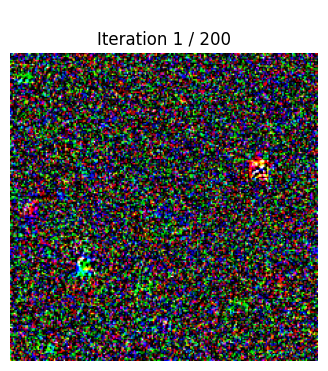

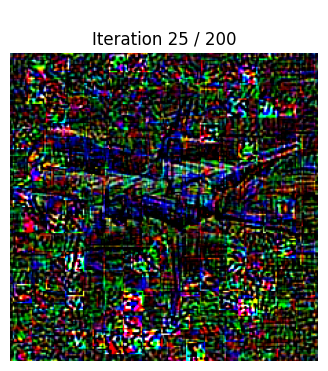

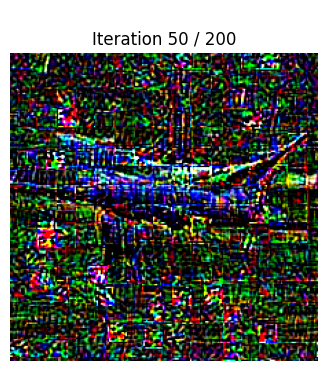

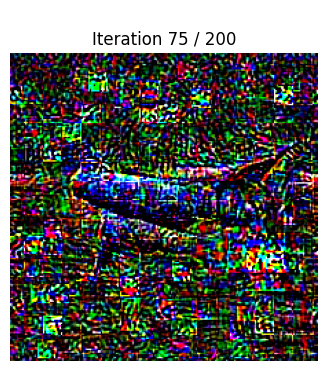

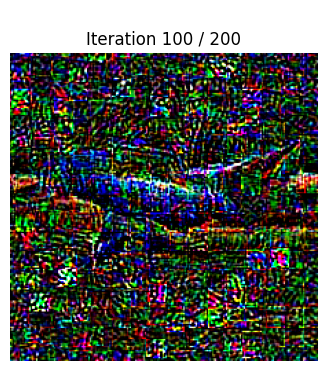

...

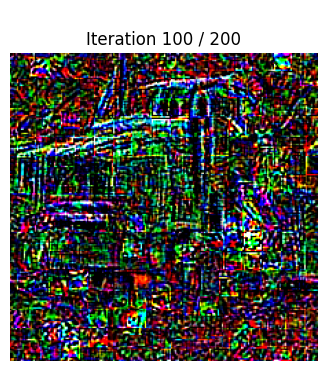

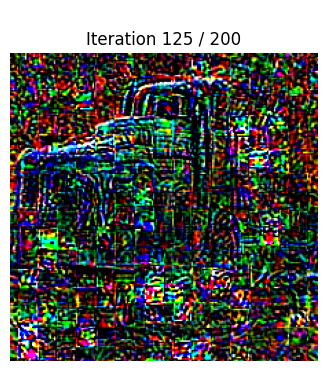

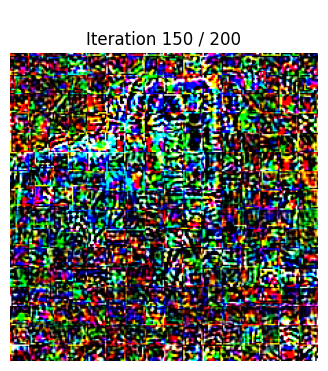

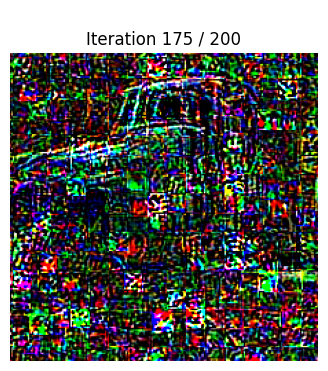

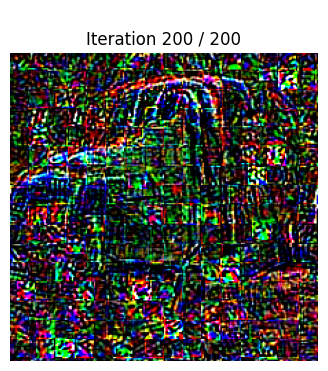

In [70]:
dtype = torch.FloatTensor
model.type(dtype)

target_y = 1

img = torch.randn(1, 3, 224, 224).mul_(1.0).type(dtype).requires_grad_()
torch.set_num_threads(5)

for target_y in range(0, 10):
    img = torch.randn(1, 3, 224, 224).mul_(1.0).type(dtype).requires_grad_()
    img = create_class_visualization(target_y, model, dtype, img, num_iterations=200)